[INFO] Loaded 7200 images from /Users/yishao/archive/balanced/train
[INFO] Training MLP...
MLP Results:
 accuracy     0.2028
precision    0.1832
recall       0.2028
f1_score     0.1839
dtype: float64
[INFO] Training KNN...
KNN Results:
 accuracy     0.1431
precision    0.3554
recall       0.1431
f1_score     0.1157
dtype: float64
[INFO] Training SVM...
SVM Results:
 accuracy     0.4590
precision    0.4563
recall       0.4590
f1_score     0.4512
dtype: float64


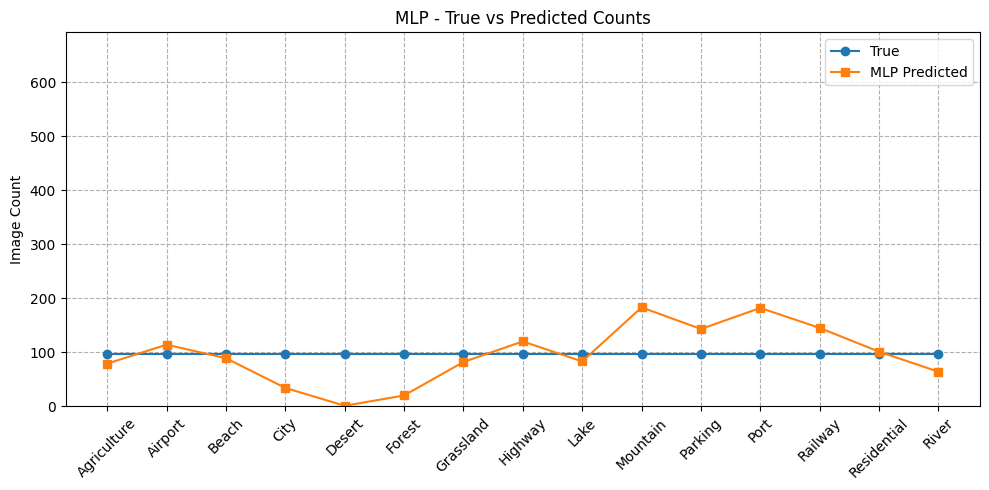

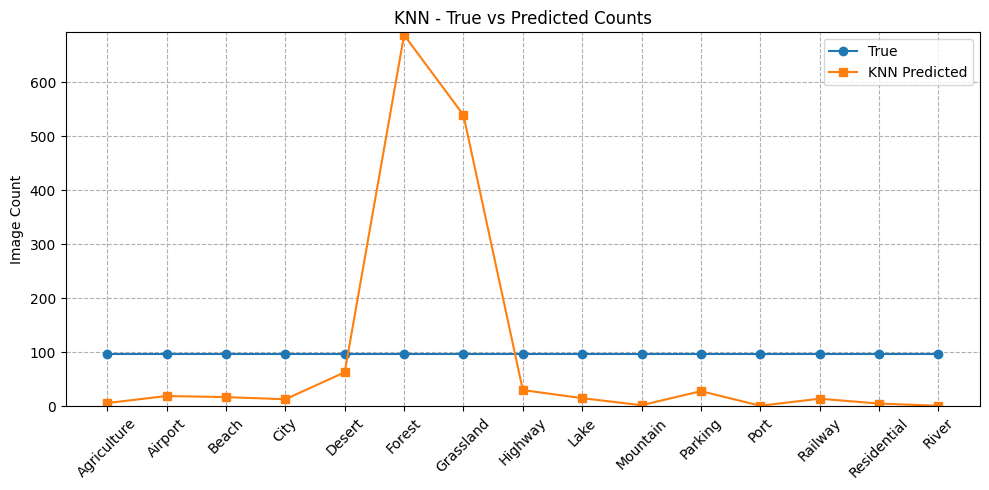

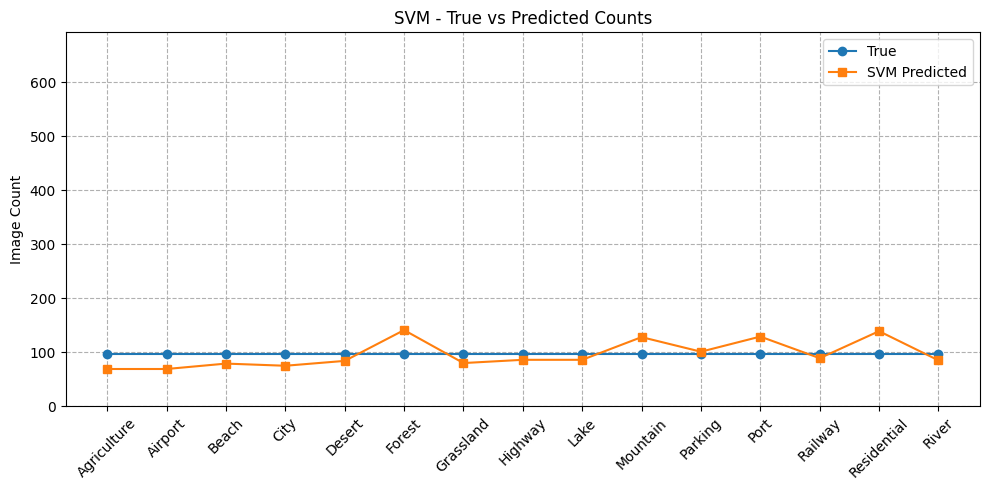

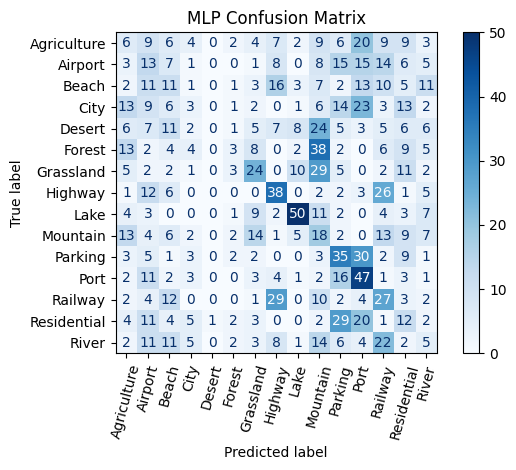

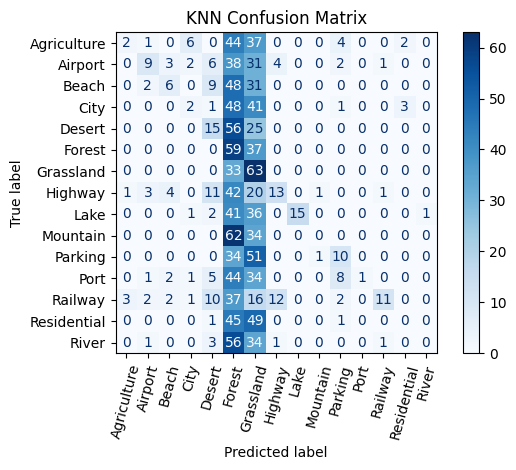

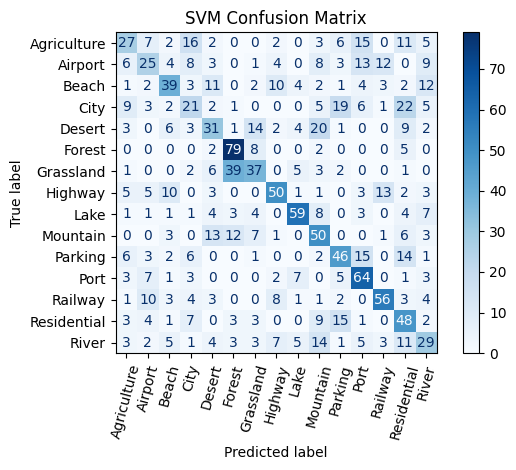

[INFO] Saved prediction results to 'skyview_prediction_results.csv'

Overall Model Performance:
     accuracy  precision  recall  f1_score
MLP    0.2028     0.1832  0.2028    0.1839
KNN    0.1431     0.3554  0.1431    0.1157
SVM    0.4590     0.4563  0.4590    0.4512


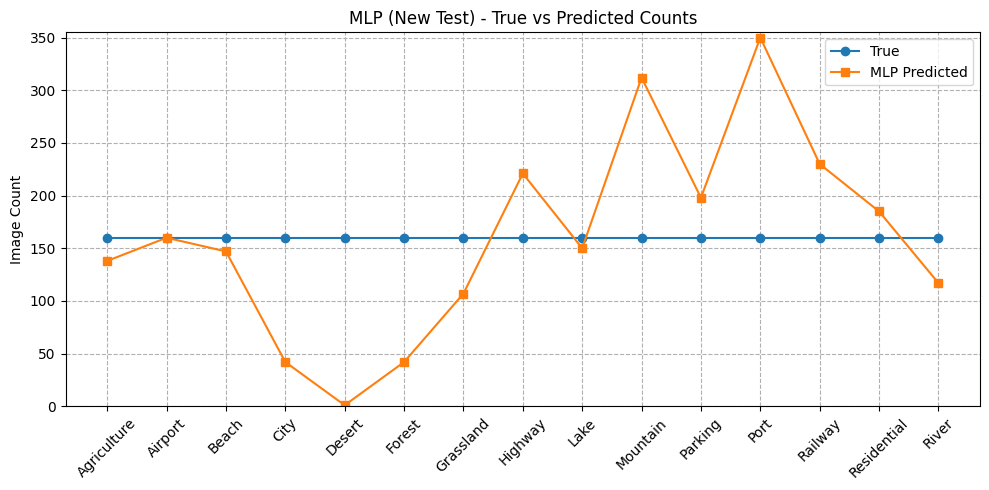

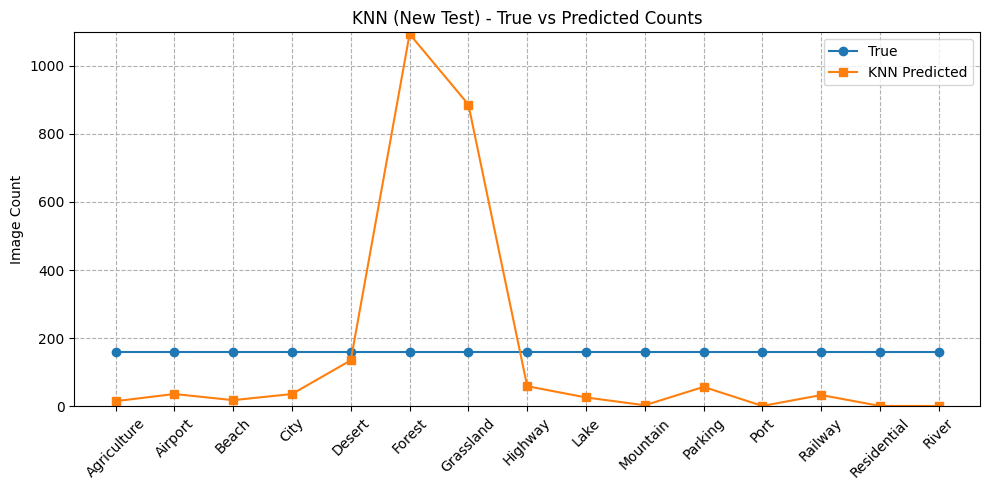

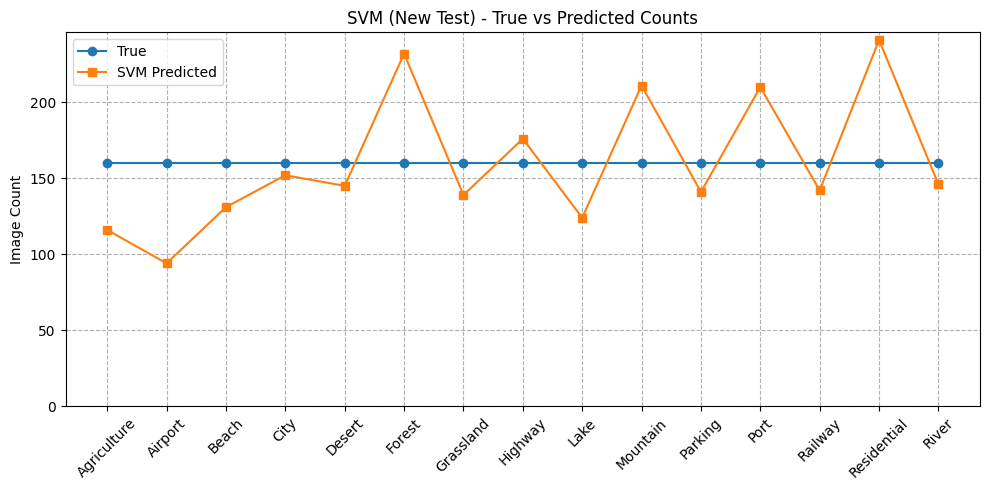

[INFO] Saved test2 predictions to 'test2_predictions.csv'


In [13]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from skimage.feature import hog
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
import pandas as pd

class Config:
    def __init__(self):
        self.BASE_DIR = "/Users/yishao/archive/balanced/train"  # 训练数据路径
        self.IMAGE_SIZE = (128, 128)
        self.CATEGORIES = sorted([
            d for d in os.listdir(self.BASE_DIR)
            if os.path.isdir(os.path.join(self.BASE_DIR, d))
        ])

cfg = Config()

def extract_features(image, pixels_per_cell=(16, 16), cells_per_block=(2, 2)):
    return hog(image, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block, feature_vector=True)

def load_data(base_dir, categories, img_size=(128, 128)):
    X, y, file_paths = [], [], []
    for label, category in enumerate(categories):
        category_path = os.path.join(base_dir, category)
        for fname in os.listdir(category_path):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                path = os.path.join(category_path, fname)
                try:
                    image = imread(path, as_gray=True)
                    image_resized = resize(image, img_size)
                    features = extract_features(image_resized)
                    X.append(features)
                    y.append(label)
                    file_paths.append(path)
                except Exception as e:
                    print(f"[ERROR] Failed to load {path}: {e}")
    print(f"[INFO] Loaded {len(X)} images from {base_dir}")
    return np.array(X), np.array(y), file_paths

def plot_model_linecharts(y_test, predictions, categories):
    x = np.arange(len(categories))
    true_counts = np.bincount(y_test, minlength=len(categories))
    y_limit = max(true_counts.max(), max(np.bincount(pred, minlength=len(categories)).max() for pred in predictions.values())) + 5

    for model_name, y_pred in predictions.items():
        pred_counts = np.bincount(y_pred, minlength=len(categories))
        plt.figure(figsize=(10, 5))
        plt.plot(x, true_counts, marker='o', label='True')
        plt.plot(x, pred_counts, marker='s', label=f'{model_name} Predicted')
        plt.xticks(x, categories, rotation=45)
        plt.ylabel("Image Count")
        plt.title(f"{model_name} - True vs Predicted Counts")
        plt.ylim(0, y_limit)
        plt.grid(True, linestyle='--')
        plt.legend()
        plt.tight_layout()
        plt.savefig(f"{model_name.lower()}_linechart.png", dpi=300)
        plt.show()

def plot_confusion_matrices(y_test, predictions, categories):
    for model_name, y_pred in predictions.items():
        cm = confusion_matrix(y_test, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=categories)
        disp.plot(xticks_rotation=75, cmap='Blues')
        plt.title(f"{model_name} Confusion Matrix")
        plt.tight_layout()
        plt.savefig(f"{model_name.lower()}_confusion_matrix.png", dpi=300)
        plt.show()

def predict_and_plot_on_labeled_testdir(test_dir, models, categories, image_size=(128, 128), output_csv="test2_predictions.csv"):
    label_map = {name: idx for idx, name in enumerate(categories)}
    X_new, y_true, file_paths = [], [], []

    for label_name in os.listdir(test_dir):
        label_path = os.path.join(test_dir, label_name)
        if not os.path.isdir(label_path) or label_name not in label_map:
            continue
        label_idx = label_map[label_name]
        for fname in os.listdir(label_path):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                path = os.path.join(label_path, fname)
                try:
                    image = imread(path, as_gray=True)
                    image_resized = resize(image, image_size)
                    features = extract_features(image_resized)
                    X_new.append(features)
                    y_true.append(label_idx)
                    file_paths.append(path)
                except Exception as e:
                    print(f"[ERROR] Failed to process {path}: {e}")

    if not X_new:
        print("[WARNING] No valid images found in labeled test directory.")
        return

    X_new = np.array(X_new)
    y_true = np.array(y_true)

    prediction_data = {
        "File": [os.path.relpath(f, test_dir) for f in file_paths],
        "True": [categories[i] for i in y_true]
    }

    predictions = {}

    for name, model in models.items():
        y_pred = model.predict(X_new)
        predictions[name] = y_pred
        prediction_data[f"{name}_Pred"] = [categories[i] for i in y_pred]
        prediction_data[f"{name}_Correct"] = (y_pred == y_true)

        # Plot
        x = np.arange(len(categories))
        true_counts = np.bincount(y_true, minlength=len(categories))
        pred_counts = np.bincount(y_pred, minlength=len(categories))
        y_limit = max(true_counts.max(), pred_counts.max()) + 5

        plt.figure(figsize=(10, 5))
        plt.plot(x, true_counts, marker='o', label='True')
        plt.plot(x, pred_counts, marker='s', label=f'{name} Predicted')
        plt.xticks(x, categories, rotation=45)
        plt.ylabel("Image Count")
        plt.title(f"{name} (New Test) - True vs Predicted Counts")
        plt.ylim(0, y_limit)
        plt.grid(True, linestyle='--')
        plt.legend()
        plt.tight_layout()
        plt.savefig(f"{name.lower()}_test2_linechart.png", dpi=300)
        plt.show()

    # Save CSV
    df = pd.DataFrame(prediction_data)
    df.to_csv(output_csv, index=False)
    print(f"[INFO] Saved test2 predictions to '{output_csv}'")

if __name__ == "__main__":
    # Load and split dataset
    X, y, file_paths = load_data(cfg.BASE_DIR, cfg.CATEGORIES, cfg.IMAGE_SIZE)
    X_train, X_test, y_train, y_test, train_files, test_files = train_test_split(
        X, y, file_paths, test_size=0.2, random_state=42, stratify=y
    )

    models = {
        'MLP': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, learning_rate_init=0.01, random_state=42),
        'KNN': KNeighborsClassifier(n_neighbors=5),
        'SVM': SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
    }

    predictions = {}
    metrics_results = {}

    for name, model in models.items():
        print(f"[INFO] Training {name}...")
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        predictions[name] = y_pred

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='macro', zero_division=0)
        recall = recall_score(y_test, y_pred, average='macro', zero_division=0)
        f1 = f1_score(y_test, y_pred, average='macro', zero_division=0)

        metrics_results[name] = {
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1_score': f1
        }

        print(f"{name} Results:\n", pd.Series(metrics_results[name]).round(4))

    plot_model_linecharts(y_test, predictions, cfg.CATEGORIES)
    plot_confusion_matrices(y_test, predictions, cfg.CATEGORIES)

    # Export original test prediction results
    prediction_data = {
        'File': [os.path.basename(f) for f in test_files],
        'True': [cfg.CATEGORIES[i] for i in y_test]
    }

    for name in models.keys():
        prediction_data[f'{name}_Pred'] = [cfg.CATEGORIES[i] for i in predictions[name]]
        prediction_data[f'{name}_Correct'] = [pred == true for pred, true in zip(predictions[name], y_test)]

    df = pd.DataFrame(prediction_data)
    df.to_csv("skyview_prediction_results.csv", index=False)
    print("[INFO] Saved prediction results to 'skyview_prediction_results.csv'")

    print("\nOverall Model Performance:")
    print(pd.DataFrame(metrics_results).T.round(4))

    labeled_test_dir = "/Users/yishao/archive/balanced/test" 
    predict_and_plot_on_labeled_testdir(labeled_test_dir, models, cfg.CATEGORIES, cfg.IMAGE_SIZE)



[INFO] Extracting SIFT features from images...
[INFO] Processing category: Agriculture
[INFO] Processing category: Airport
[INFO] Processing category: Beach
[INFO] Processing category: City
[INFO] Processing category: Desert
[INFO] Processing category: Forest
[INFO] Processing category: Grassland
[INFO] Processing category: Highway
[INFO] Processing category: Lake
[INFO] Processing category: Mountain
[INFO] Processing category: Parking
[INFO] Processing category: Port
[INFO] Processing category: Railway
[INFO] Processing category: Residential
[INFO] Processing category: River
[INFO] Loaded 7200 images from /Users/yishao/archive/balanced/train
[INFO] Visualizing SIFT keypoints on sample images...


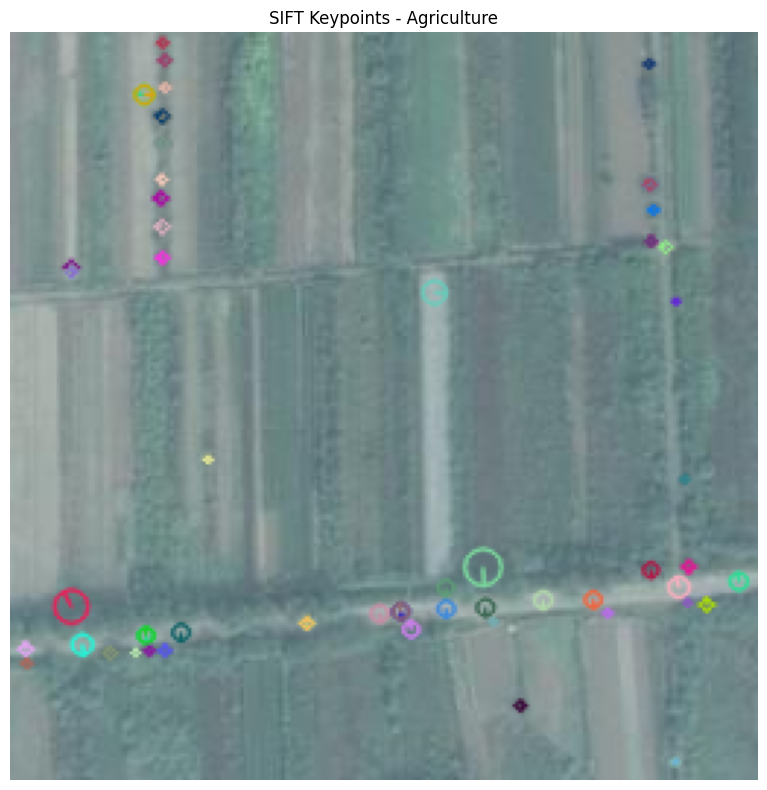

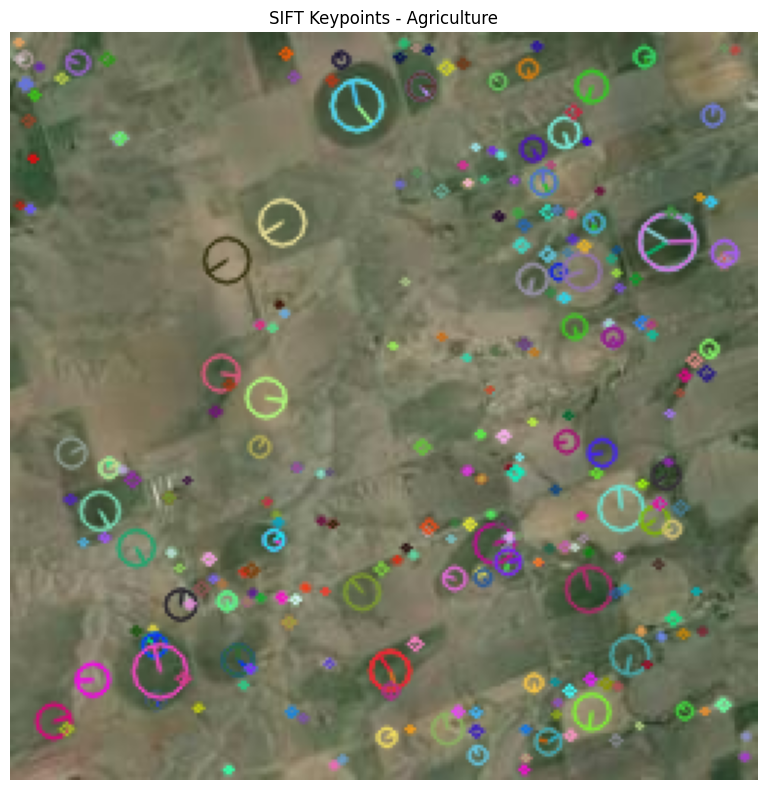

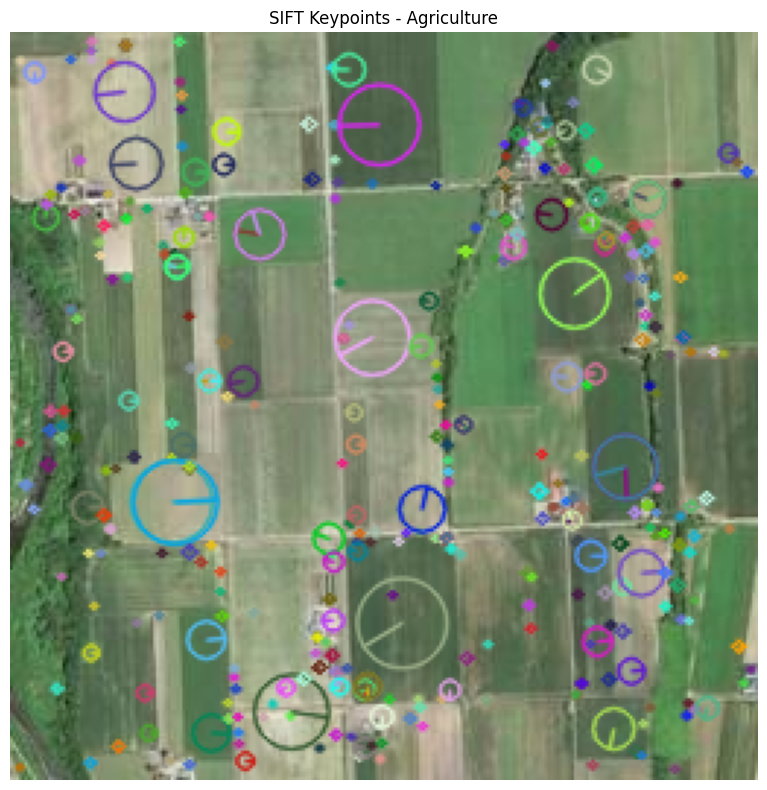

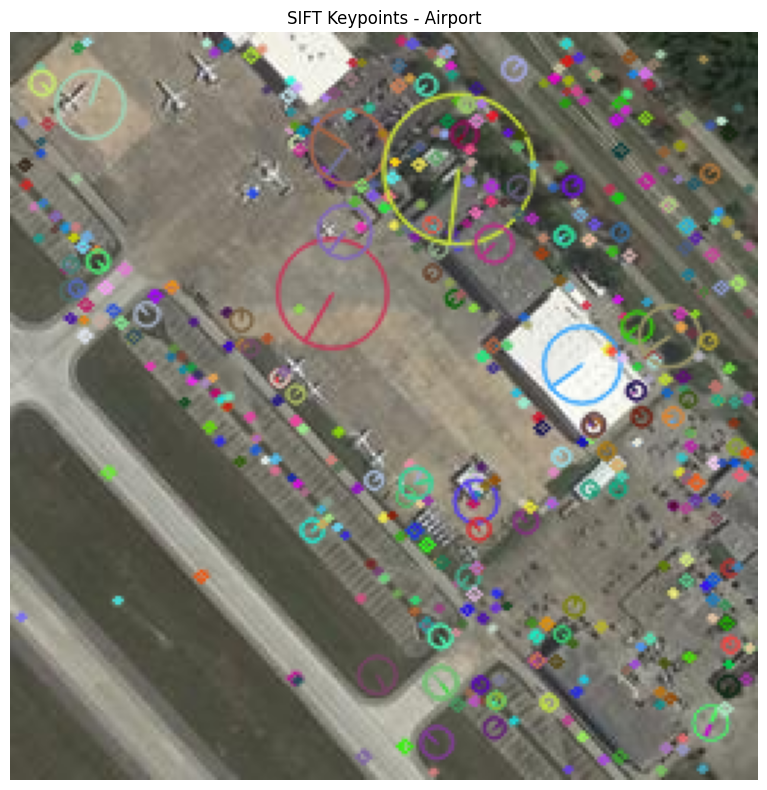

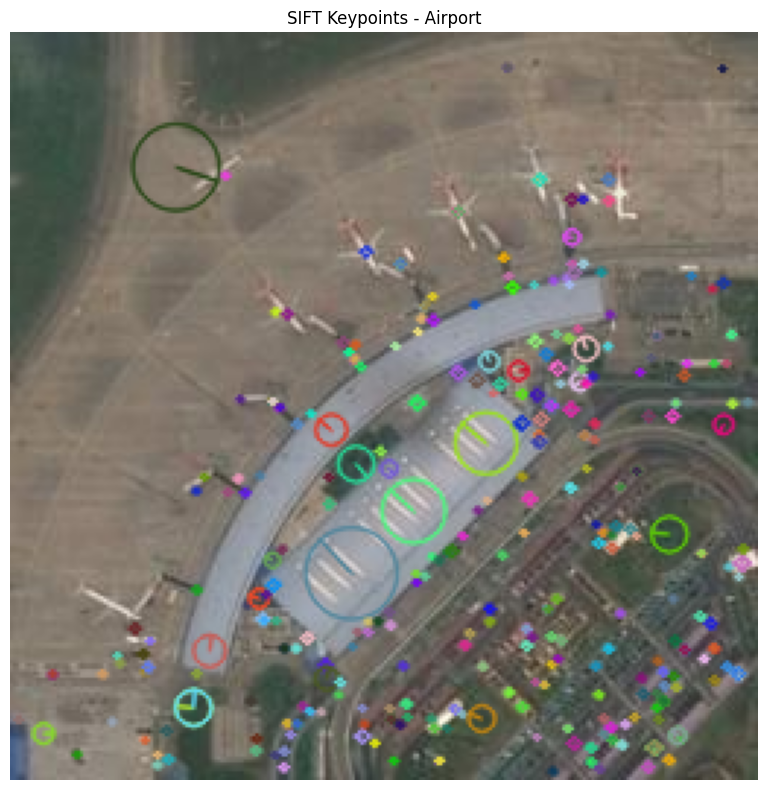

...

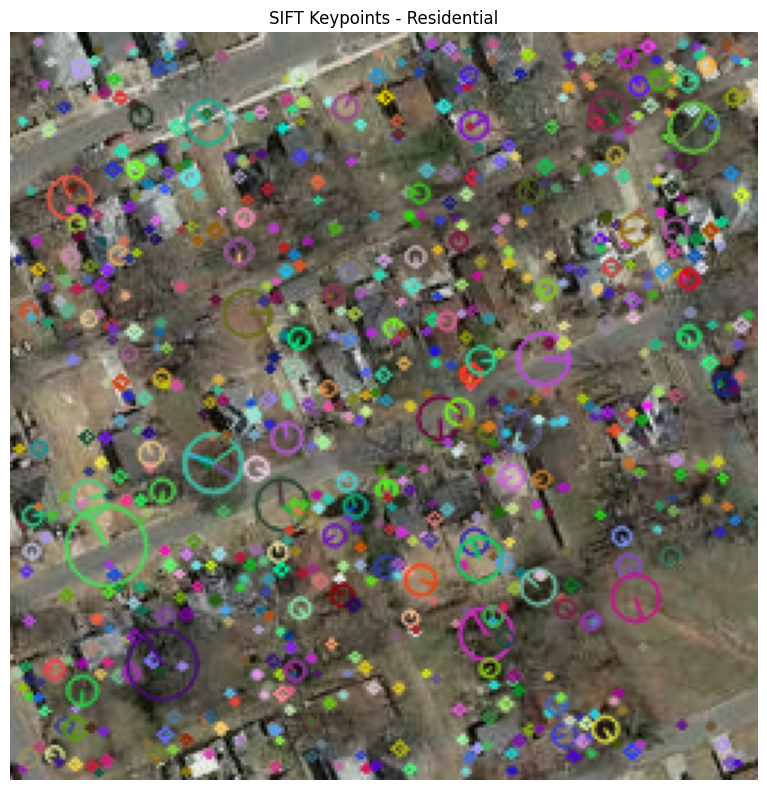

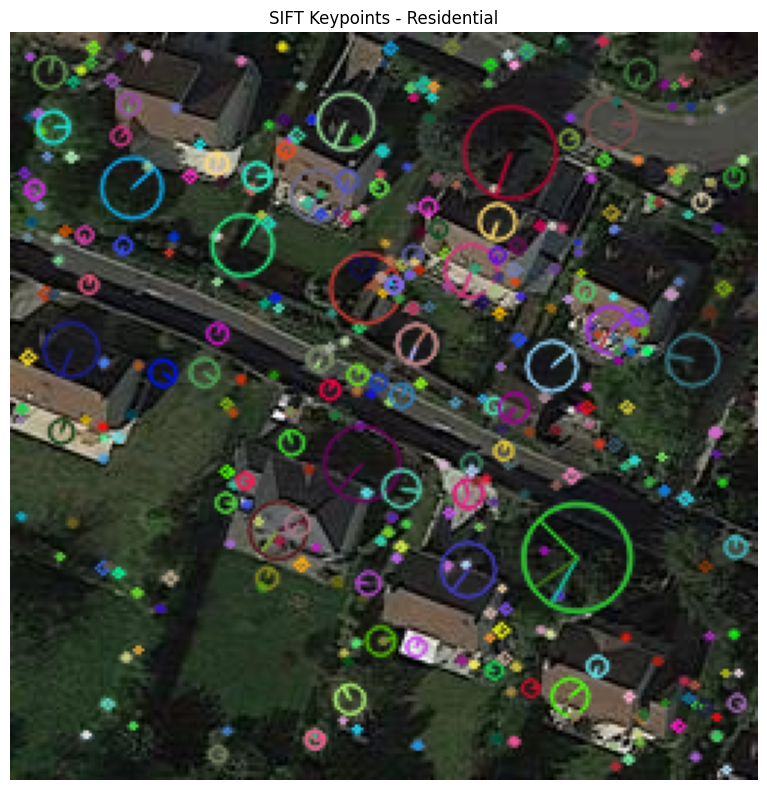

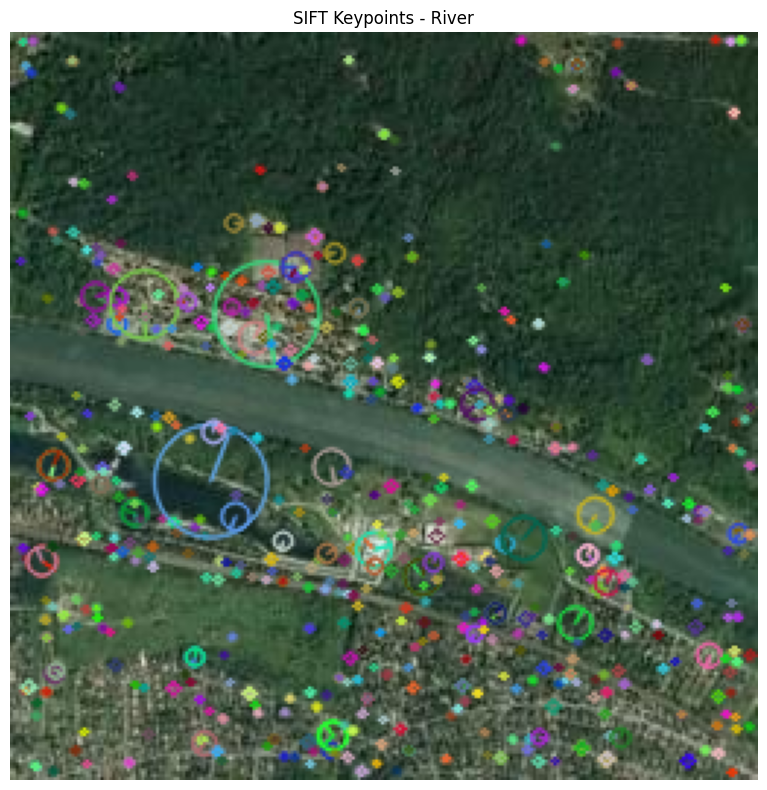

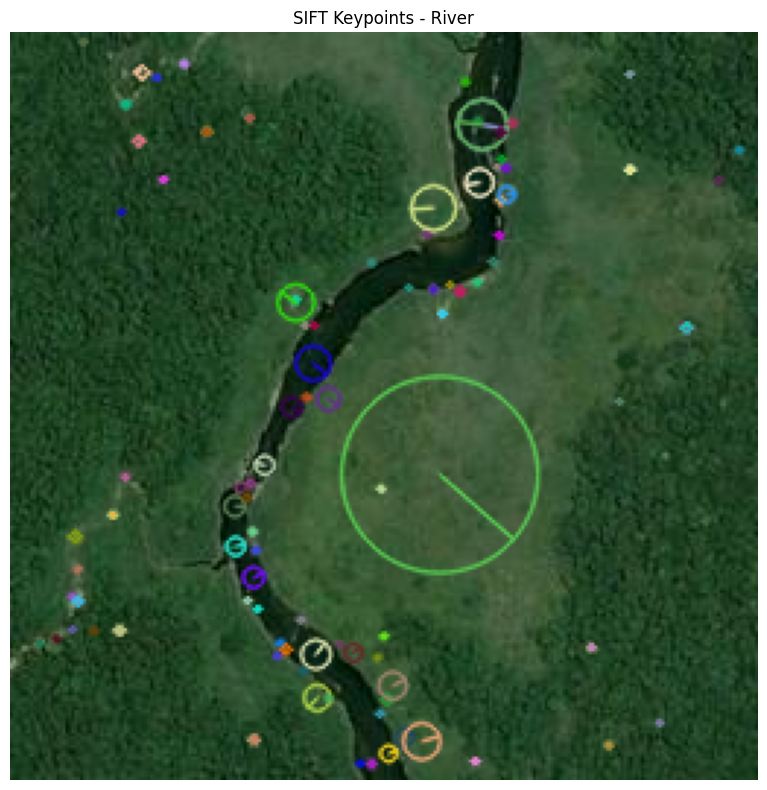

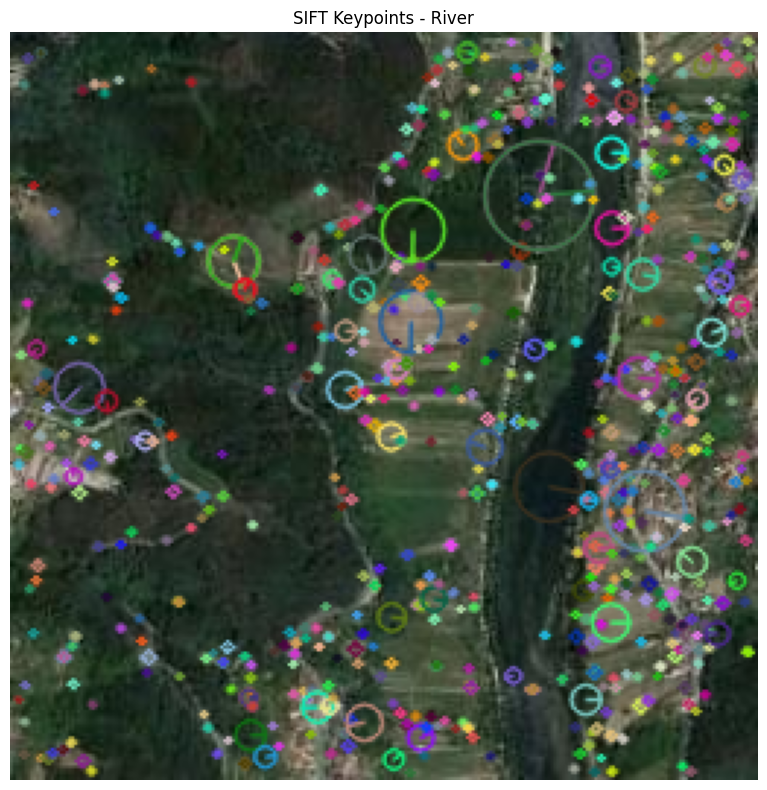

[INFO] Training MLP with SIFT features...
MLP Results:
 accuracy     0.0792
precision    0.0379
recall       0.0792
f1_score     0.0267
dtype: float64
[INFO] Training KNN with SIFT features...
KNN Results:
 accuracy     0.1535
precision    0.1198
recall       0.1535
f1_score     0.1066
dtype: float64
[INFO] Training SVM with SIFT features...
SVM Results:
 accuracy     0.4042
precision    0.4112
recall       0.4042
f1_score     0.3886
dtype: float64


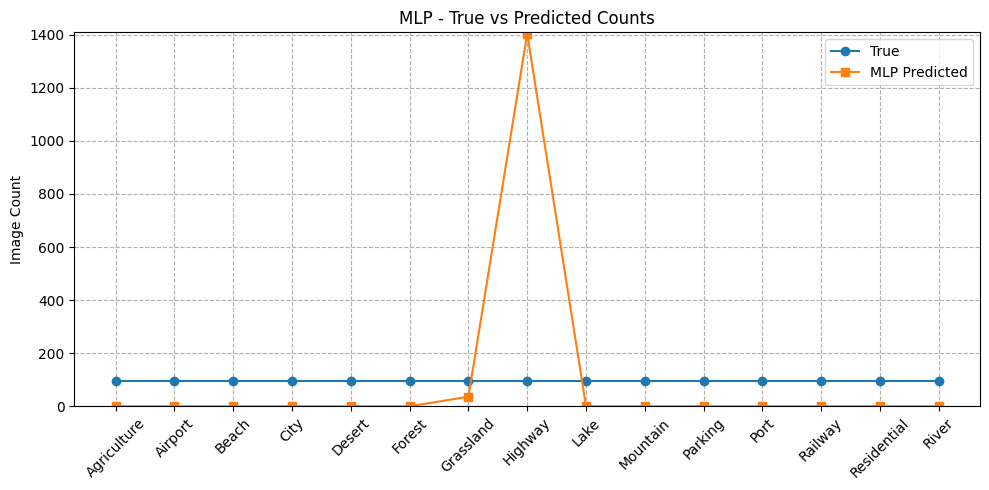

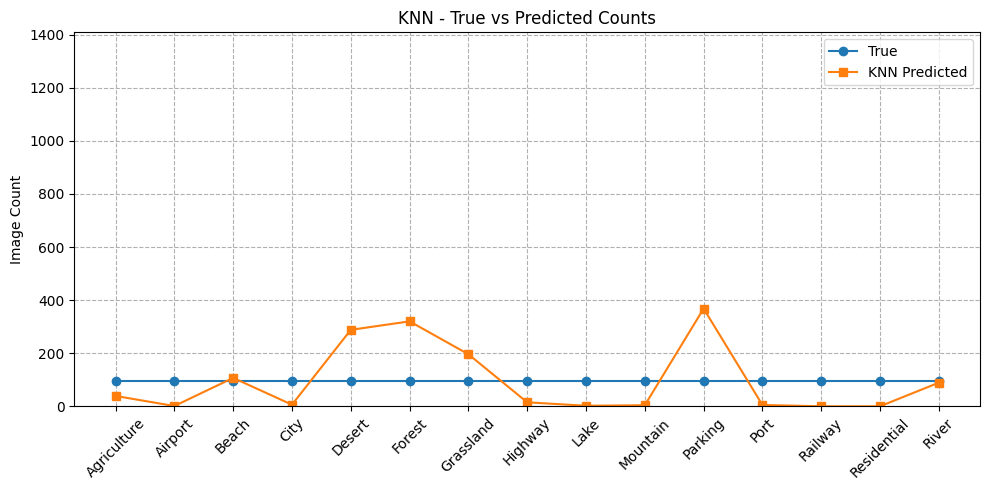

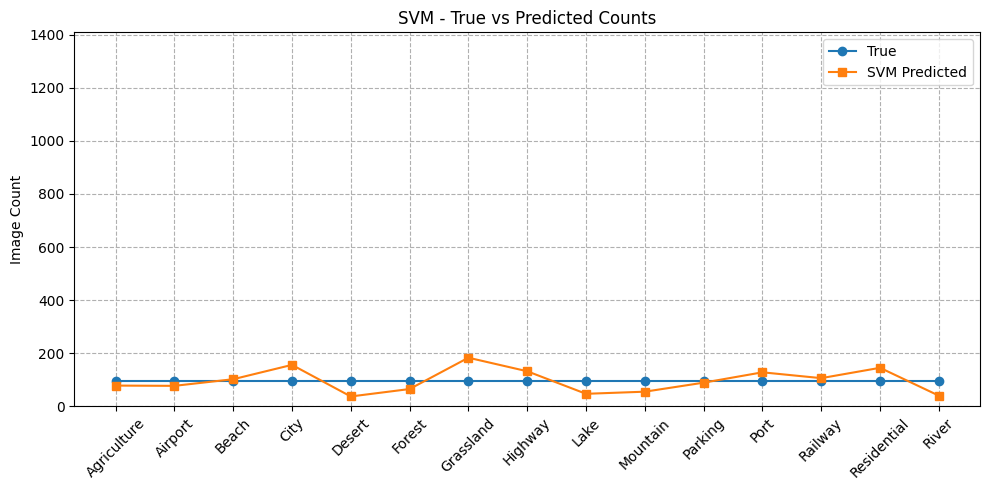

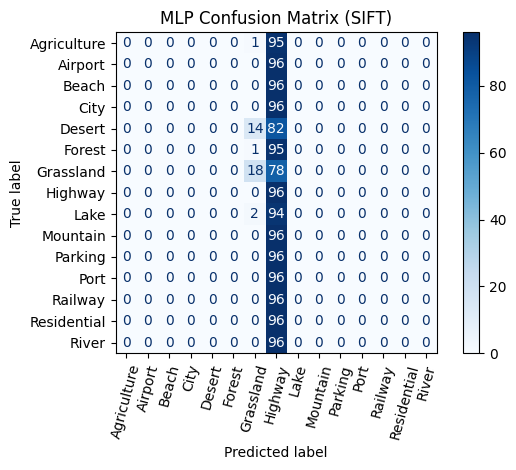

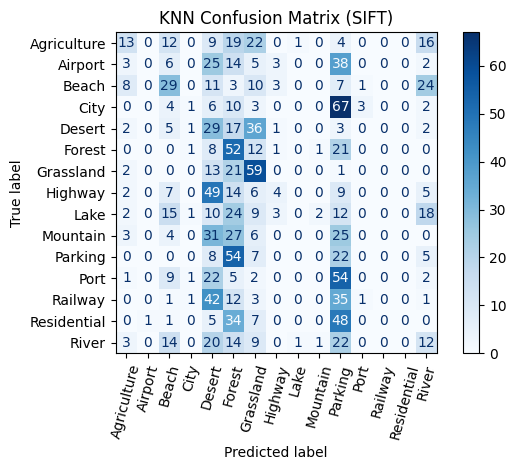

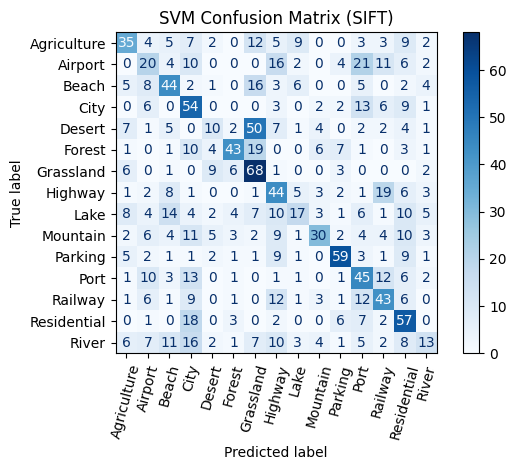

[INFO] Saved prediction results to 'skyview_sift_prediction_results.csv'

Overall Model Performance (SIFT):
     accuracy  precision  recall  f1_score
MLP    0.0792     0.0379  0.0792    0.0267
KNN    0.1535     0.1198  0.1535    0.1066
SVM    0.4042     0.4112  0.4042    0.3886


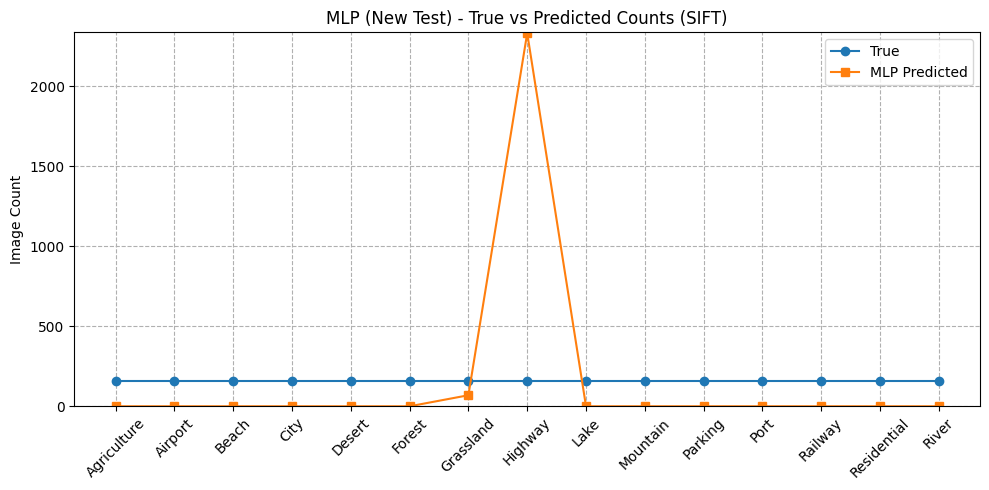

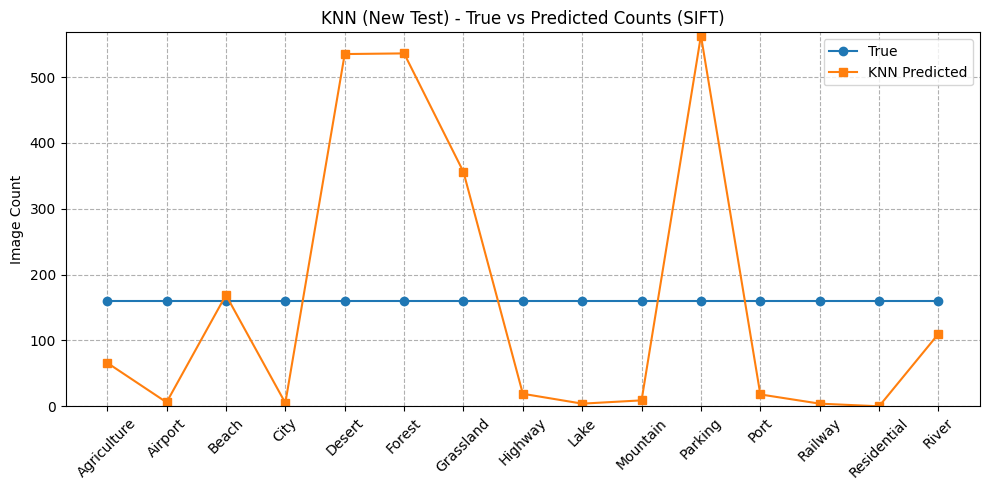

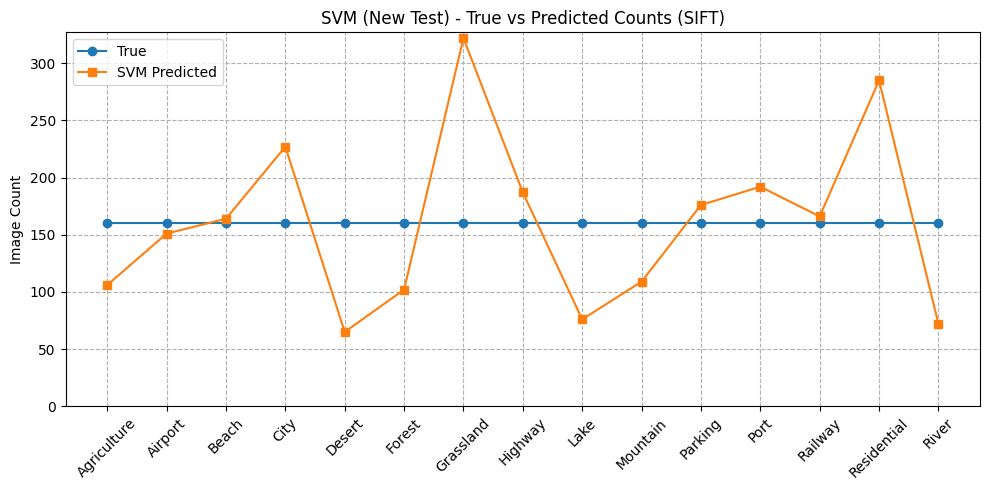

[INFO] Saved test2 predictions to 'test2_sift_predictions.csv'


In [15]:
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage.io import imread
from skimage.transform import resize
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import train_test_split
import pandas as pd
import cv2  # Required for SIFT

class Config:
    def __init__(self):
        self.BASE_DIR = "/Users/yishao/archive/balanced/train"  # Training data path
        self.IMAGE_SIZE = (128, 128)
        self.CATEGORIES = sorted([
            d for d in os.listdir(self.BASE_DIR)
            if os.path.isdir(os.path.join(self.BASE_DIR, d))
        ])
        # SIFT Configuration
        self.NUM_FEATURES = 100  # Max number of keypoints to extract

cfg = Config()

def extract_sift_features(image, num_features=100):
    # Convert the image to uint8 as required by SIFT
    if image.dtype != np.uint8:
        image = (image * 255).astype(np.uint8)
    
    # Initialize SIFT detector
    sift = cv2.SIFT_create(nfeatures=num_features)
    
    # Detect keypoints and compute descriptors
    keypoints, descriptors = sift.detectAndCompute(image, None)
    
    # Check if no keypoints were found
    if descriptors is None or len(keypoints) == 0:
        # Return a zero vector of appropriate size as fallback
        return np.zeros(128 * num_features)
    
    # If fewer keypoints than expected, pad with zeros
    if len(keypoints) < num_features:
        padding = np.zeros((num_features - len(keypoints), 128))
        descriptors = np.vstack([descriptors, padding])
    # If more keypoints than needed, take only the first num_features
    elif len(keypoints) > num_features:
        descriptors = descriptors[:num_features]
    
    # Flatten the descriptor to create a feature vector
    return descriptors.flatten()

def load_data(base_dir, categories, img_size=(128, 128), num_features=100):
    X, y, file_paths = [], [], []
    for label, category in enumerate(categories):
        category_path = os.path.join(base_dir, category)
        print(f"[INFO] Processing category: {category}")
        for fname in os.listdir(category_path):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                path = os.path.join(category_path, fname)
                try:
                    # Read as grayscale
                    image = imread(path, as_gray=True)
                    image_resized = resize(image, img_size)
                    features = extract_sift_features(image_resized, num_features)
                    X.append(features)
                    y.append(label)
                    file_paths.append(path)
                except Exception as e:
                    print(f"[ERROR] Failed to load {path}: {e}")
    print(f"[INFO] Loaded {len(X)} images from {base_dir}")
    return np.array(X), np.array(y), file_paths

def plot_model_linecharts(y_test, predictions, categories):
    x = np.arange(len(categories))
    true_counts = np.bincount(y_test, minlength=len(categories))
    y_limit = max(true_counts.max(), max(np.bincount(pred, minlength=len(categories)).max() for pred in predictions.values())) + 5

    for model_name, y_pred in predictions.items():
        pred_counts = np.bincount(y_pred, minlength=len(categories))
        plt.figure(figsize=(10, 5))
        plt.plot(x, true_counts, marker='o', label='True')
        plt.plot(x, pred_counts, marker='s', label=f'{model_name} Predicted')
        plt.xticks(x, categories, rotation=45)
        plt.ylabel("Image Count")
        plt.title(f"{model_name} - True vs Predicted Counts")
        plt.ylim(0, y_limit)
        plt.grid(True, linestyle='--')
        plt.legend()
        plt.tight_layout()
        plt.savefig(f"{model_name.lower()}_sift_linechart.png", dpi=300)
        plt.show()

def plot_confusion_matrices(y_test, predictions, categories):
    for model_name, y_pred in predictions.items():
        cm = confusion_matrix(y_test, y_pred)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=categories)
        disp.plot(xticks_rotation=75, cmap='Blues')
        plt.title(f"{model_name} Confusion Matrix (SIFT)")
        plt.tight_layout()
        plt.savefig(f"{model_name.lower()}_sift_confusion_matrix.png", dpi=300)
        plt.show()

def predict_and_plot_on_labeled_testdir(test_dir, models, categories, image_size=(128, 128), num_features=100, output_csv="test2_sift_predictions.csv"):
    label_map = {name: idx for idx, name in enumerate(categories)}
    X_new, y_true, file_paths = [], [], []

    for label_name in os.listdir(test_dir):
        label_path = os.path.join(test_dir, label_name)
        if not os.path.isdir(label_path) or label_name not in label_map:
            continue
        label_idx = label_map[label_name]
        for fname in os.listdir(label_path):
            if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
                path = os.path.join(label_path, fname)
                try:
                    image = imread(path, as_gray=True)
                    image_resized = resize(image, image_size)
                    features = extract_sift_features(image_resized, num_features)
                    X_new.append(features)
                    y_true.append(label_idx)
                    file_paths.append(path)
                except Exception as e:
                    print(f"[ERROR] Failed to process {path}: {e}")

    if not X_new:
        print("[WARNING] No valid images found in labeled test directory.")
        return

    X_new = np.array(X_new)
    y_true = np.array(y_true)

    prediction_data = {
        "File": [os.path.relpath(f, test_dir) for f in file_paths],
        "True": [categories[i] for i in y_true]
    }

    predictions = {}

    for name, model in models.items():
        y_pred = model.predict(X_new)
        predictions[name] = y_pred
        prediction_data[f"{name}_Pred"] = [categories[i] for i in y_pred]
        prediction_data[f"{name}_Correct"] = (y_pred == y_true)

        # Plot
        x = np.arange(len(categories))
        true_counts = np.bincount(y_true, minlength=len(categories))
        pred_counts = np.bincount(y_pred, minlength=len(categories))
        y_limit = max(true_counts.max(), pred_counts.max()) + 5

        plt.figure(figsize=(10, 5))
        plt.plot(x, true_counts, marker='o', label='True')
        plt.plot(x, pred_counts, marker='s', label=f'{name} Predicted')
        plt.xticks(x, categories, rotation=45)
        plt.ylabel("Image Count")
        plt.title(f"{name} (New Test) - True vs Predicted Counts (SIFT)")
        plt.ylim(0, y_limit)
        plt.grid(True, linestyle='--')
        plt.legend()
        plt.tight_layout()
        plt.savefig(f"{name.lower()}_test2_sift_linechart.png", dpi=300)
        plt.show()

    # Save CSV
    df = pd.DataFrame(prediction_data)
    df.to_csv(output_csv, index=False)
    print(f"[INFO] Saved test2 predictions to '{output_csv}'")

def visualize_sift_keypoints(image_path, num_images=3):
    """Visualize SIFT keypoints on sample images"""
    # Get random sample images from each category
    sample_images = []
    for category in cfg.CATEGORIES:
        category_path = os.path.join(cfg.BASE_DIR, category)
        files = [f for f in os.listdir(category_path) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
        if files:
            selected = np.random.choice(files, min(num_images, len(files)), replace=False)
            for fname in selected:
                sample_images.append((os.path.join(category_path, fname), category))
    
    # Process each sample image
    for img_path, category in sample_images:
        # Read image
        img = cv2.imread(img_path)
        if img is None:
            print(f"[ERROR] Could not read {img_path}")
            continue
        
        # Convert to grayscale for SIFT
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        # Initialize SIFT detector
        sift = cv2.SIFT_create()
        
        # Detect keypoints
        keypoints = sift.detect(gray, None)
        
        # Draw keypoints
        img_with_keypoints = cv2.drawKeypoints(img, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
        
        # Display image with keypoints
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(img_with_keypoints, cv2.COLOR_BGR2RGB))
        plt.title(f"SIFT Keypoints - {category}")
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(f"sift_keypoints_{category}_{os.path.basename(img_path)}.png", dpi=300)
        plt.show()

if __name__ == "__main__":
    # Load and split dataset
    print("[INFO] Extracting SIFT features from images...")
    X, y, file_paths = load_data(cfg.BASE_DIR, cfg.CATEGORIES, cfg.IMAGE_SIZE, cfg.NUM_FEATURES)
    X_train, X_test, y_train, y_test, train_files, test_files = train_test_split(
        X, y, file_paths, test_size=0.2, random_state=42, stratify=y
    )

    # Visualize SIFT keypoints on sample images
    print("[INFO] Visualizing SIFT keypoints on sample images...")
    visualize_sift_keypoints(cfg.BASE_DIR)

    models = {
        'MLP': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, learning_rate_init=0.01, random_state=42),
        'KNN': KNeighborsClassifier(n_neighbors=5),
        'SVM': SVC(kernel='rbf', C=1.0, gamma='scale', random_state=42)
    }

    predictions = {}
    metrics_results = {}

    for name, model in models.items():
        print(f"[INFO] Training {name} with SIFT features...")
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        predictions[name] = y_pred

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='macro', zero_division=0)
        recall = recall_score(y_test, y_pred, average='macro', zero_division=0)
        f1 = f1_score(y_test, y_pred, average='macro', zero_division=0)

        metrics_results[name] = {
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1_score': f1
        }

        print(f"{name} Results:\n", pd.Series(metrics_results[name]).round(4))

    plot_model_linecharts(y_test, predictions, cfg.CATEGORIES)
    plot_confusion_matrices(y_test, predictions, cfg.CATEGORIES)

    # Export original test prediction results
    prediction_data = {
        'File': [os.path.basename(f) for f in test_files],
        'True': [cfg.CATEGORIES[i] for i in y_test]
    }

    for name in models.keys():
        prediction_data[f'{name}_Pred'] = [cfg.CATEGORIES[i] for i in predictions[name]]
        prediction_data[f'{name}_Correct'] = [pred == true for pred, true in zip(predictions[name], y_test)]

    df = pd.DataFrame(prediction_data)
    df.to_csv("skyview_sift_prediction_results.csv", index=False)
    print("[INFO] Saved prediction results to 'skyview_sift_prediction_results.csv'")

    print("\nOverall Model Performance (SIFT):")
    print(pd.DataFrame(metrics_results).T.round(4))

    labeled_test_dir = "/Users/yishao/archive/balanced/test" 
    predict_and_plot_on_labeled_testdir(labeled_test_dir, models, cfg.CATEGORIES, cfg.IMAGE_SIZE, cfg.NUM_FEATURES)